In [13]:

import numpy as np
import skimage.morphology as morpho  
from skimage import img_as_float
import matplotlib.pyplot as plt
import cv2
from tools import *
from Patch_priorities import *
from iter_algo import *
import torch

# Bourgerag

In [71]:
image_brg = cv2.imread("Bouregrag.jpg", 1)

In [88]:
mask_brg = mask(image_brg, 390, 550, 350+35, 450+35)

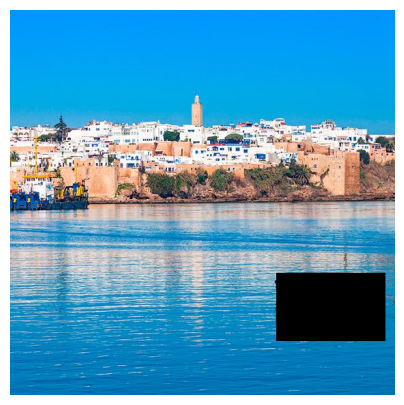

In [89]:
new_img_brg = delete_zone(image_brg, mask_brg)
view_data(new_img_brg)  

C:\Users\oumai\AppData\Local\Temp\ipykernel_24400\92417583.py:16: RuntimeWarning: invalid value encountered in scalar divide
  c[k,l]=np.sum(patch)/(patch.shape[0]*patch.shape[1])


Iteration 0 completed


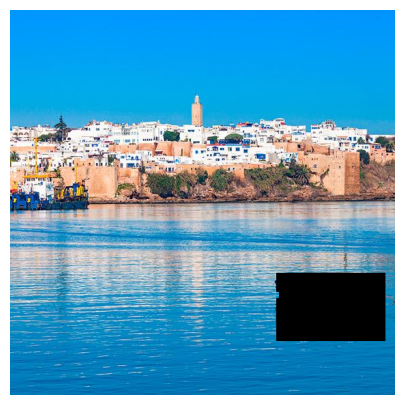

Iteration 10 completed


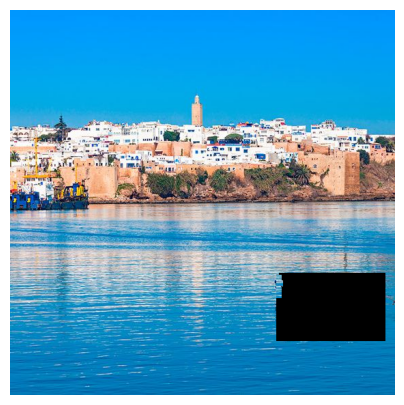

Iteration 20 completed


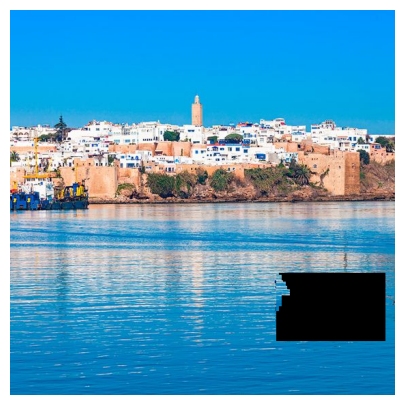

Iteration 30 completed


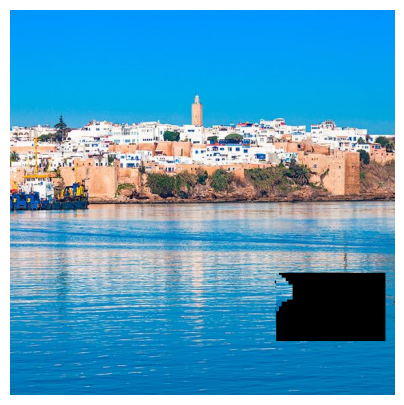

Iteration 40 completed


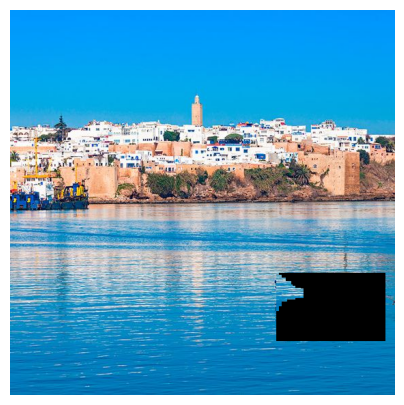

Iteration 50 completed


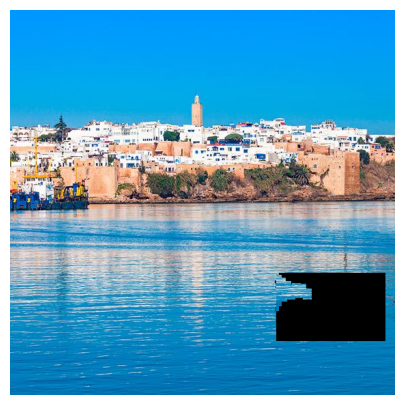

Iteration 60 completed


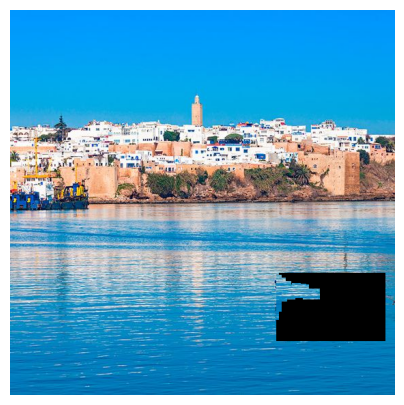

Iteration 70 completed


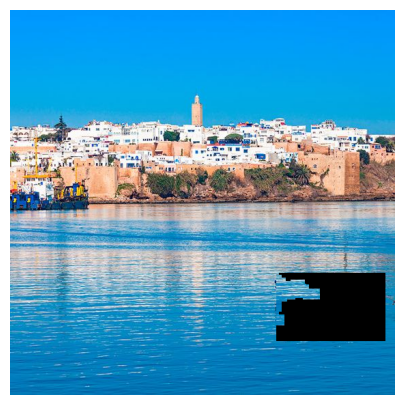

Iteration 80 completed


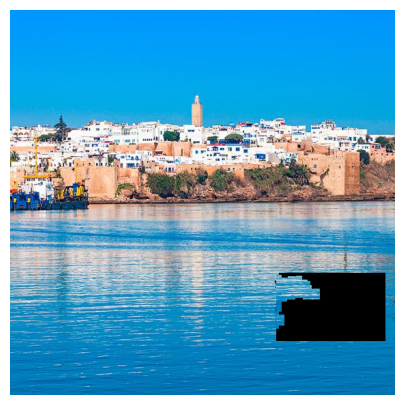

Iteration 90 completed


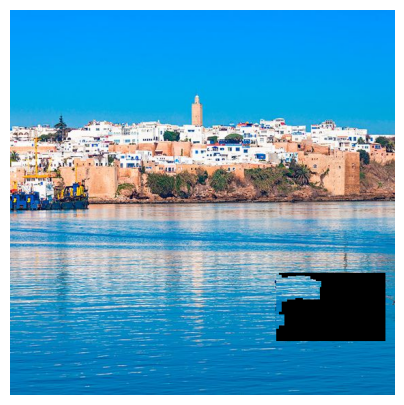

Iteration 100 completed


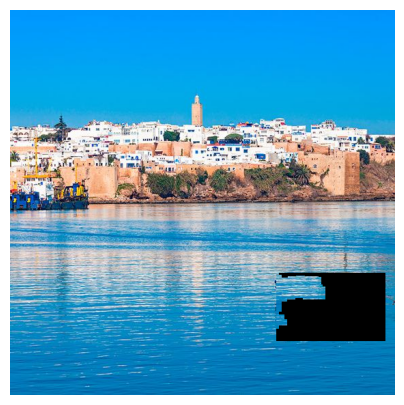

Iteration 110 completed


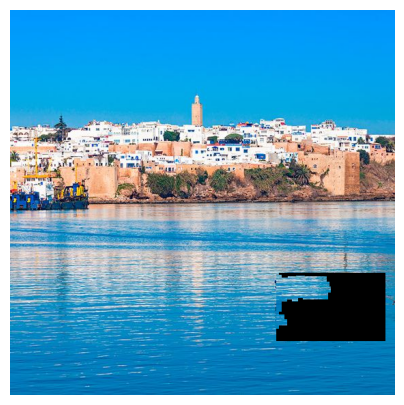

Iteration 120 completed


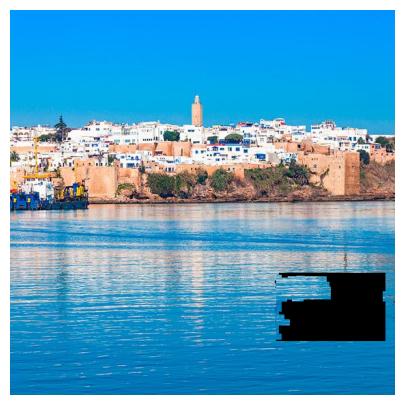

Iteration 130 completed


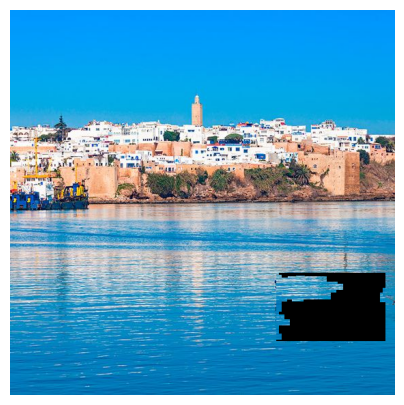

Iteration 140 completed


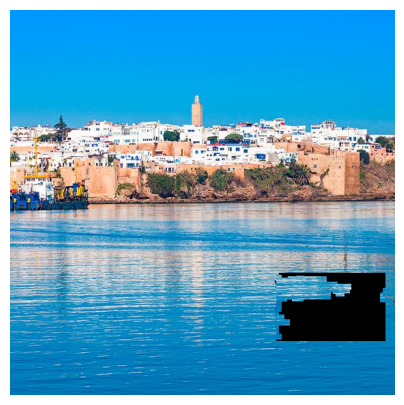

Iteration 150 completed


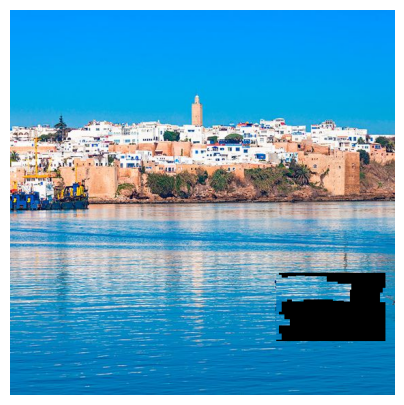

Iteration 160 completed


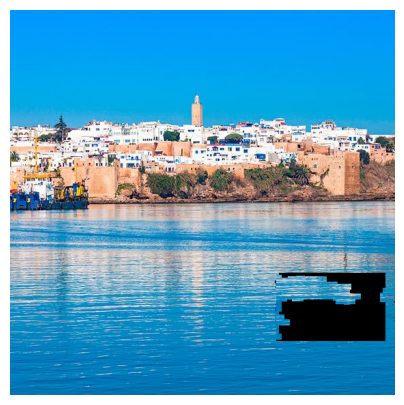

Iteration 170 completed


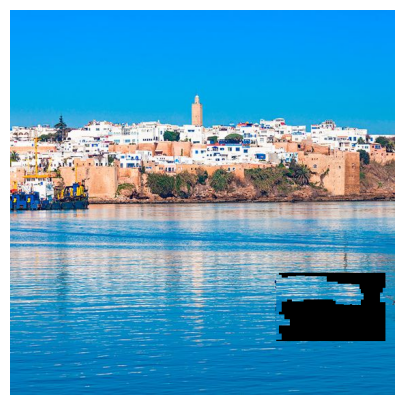

Iteration 180 completed


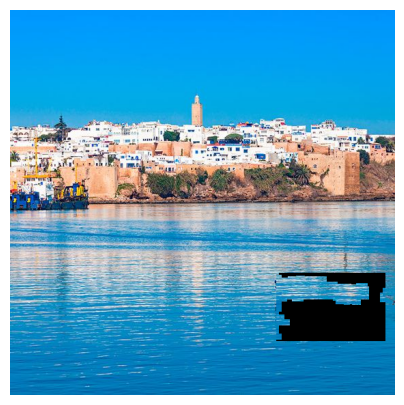

Iteration 190 completed


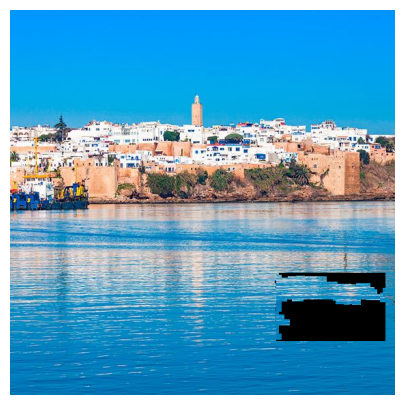

Iteration 200 completed


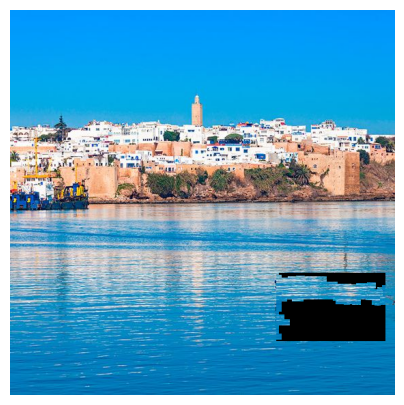

Iteration 210 completed


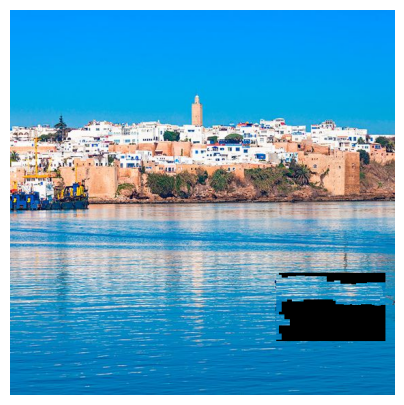

Iteration 220 completed


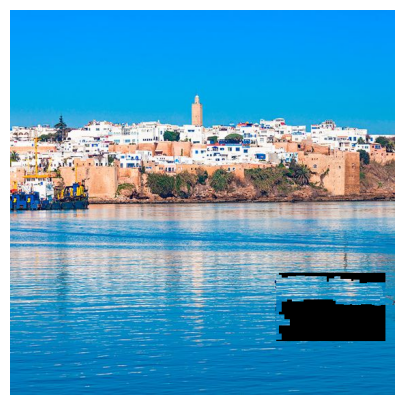

Iteration 230 completed


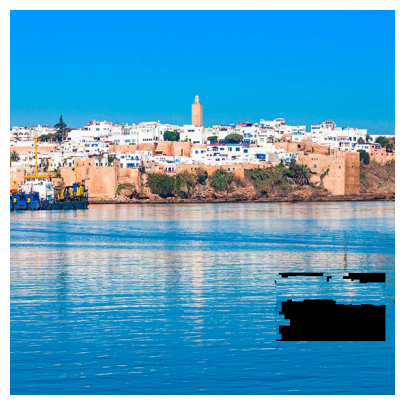

Iteration 240 completed


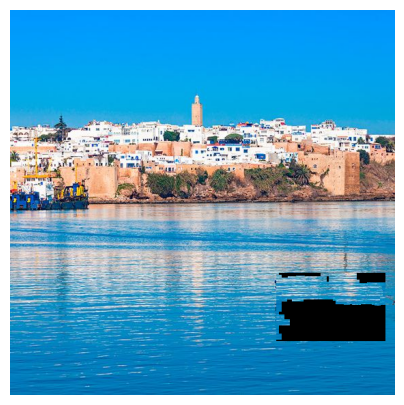

Iteration 250 completed


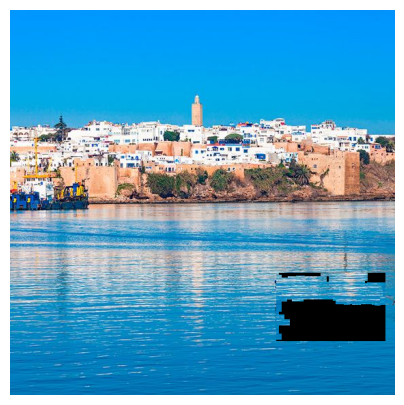

Iteration 260 completed


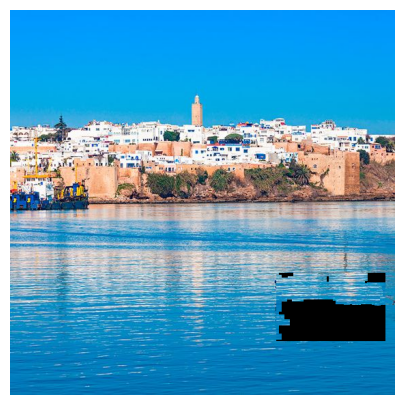

Iteration 270 completed


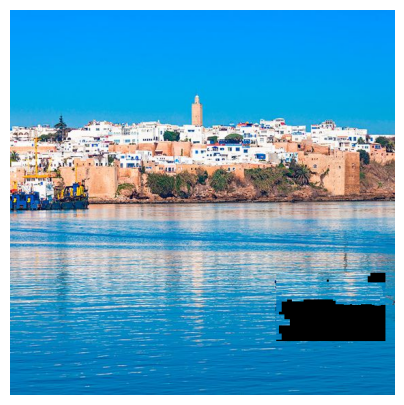

Iteration 280 completed


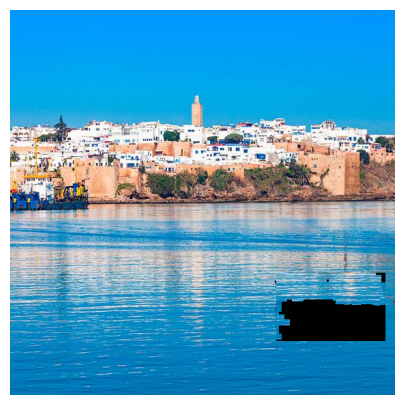

Iteration 290 completed


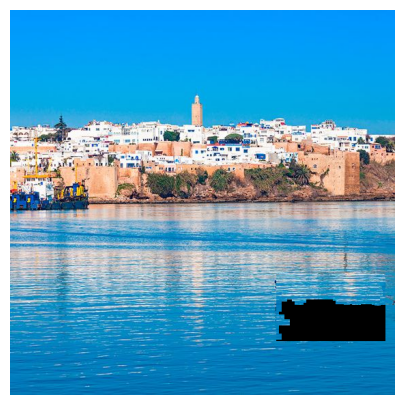

Iteration 300 completed


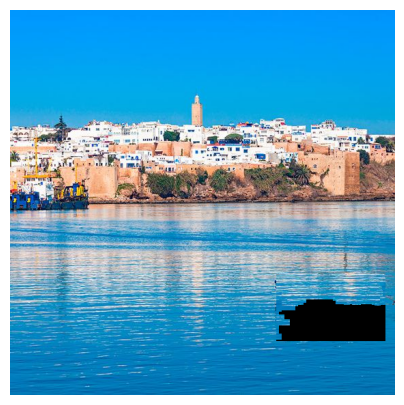

Iteration 310 completed


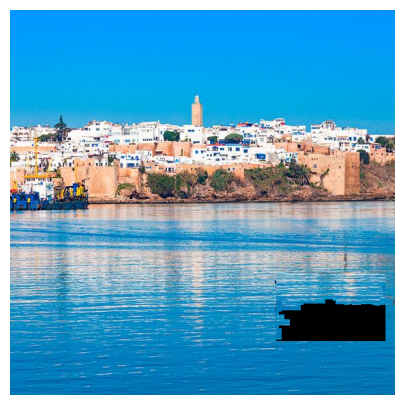

Iteration 320 completed


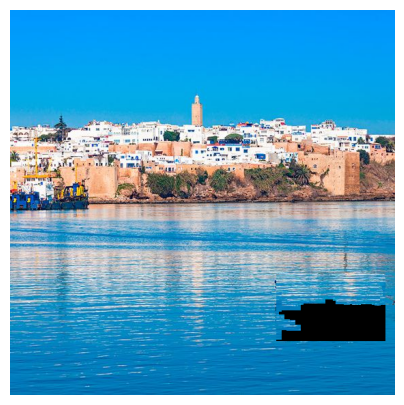

Iteration 330 completed


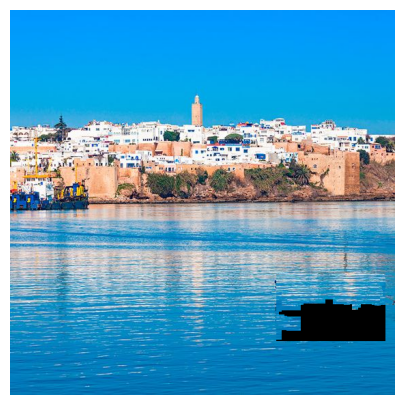

Iteration 340 completed


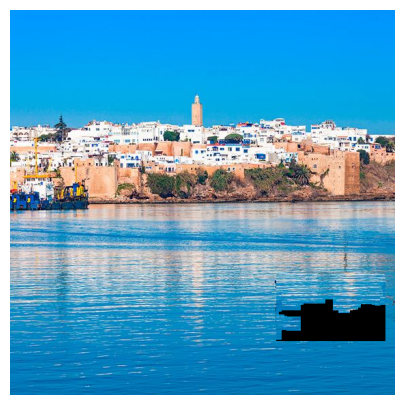

Iteration 350 completed


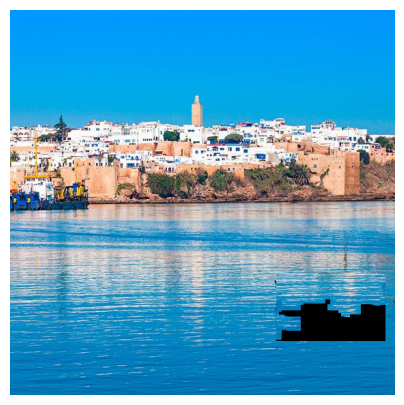

Iteration 360 completed


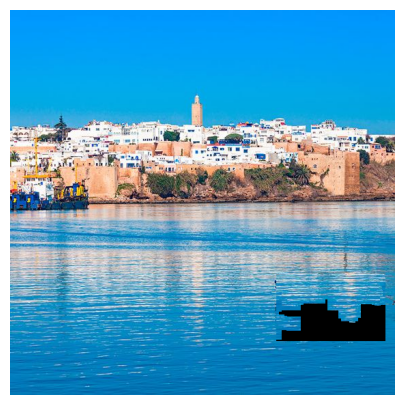

Iteration 370 completed


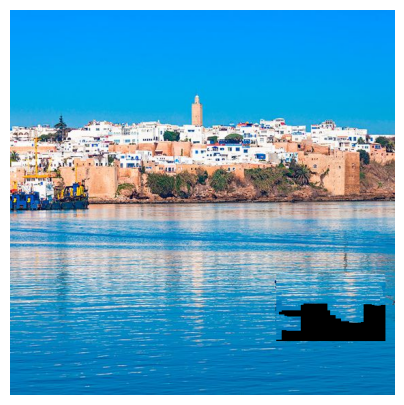

Iteration 380 completed


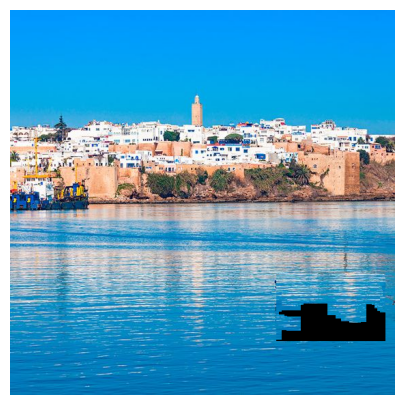

Iteration 390 completed


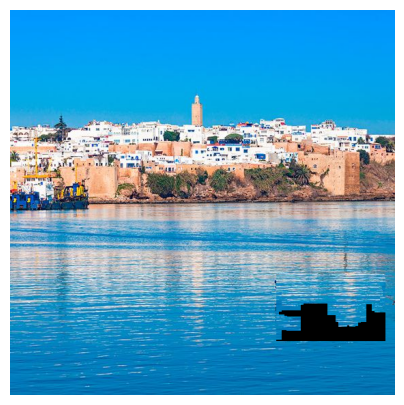

Iteration 400 completed


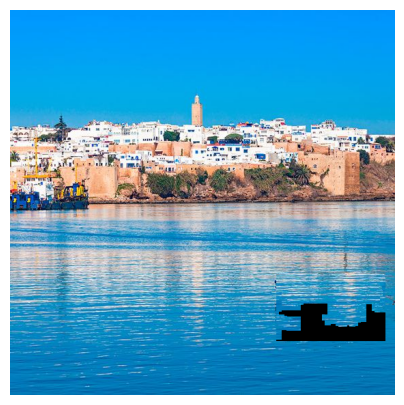

Iteration 410 completed


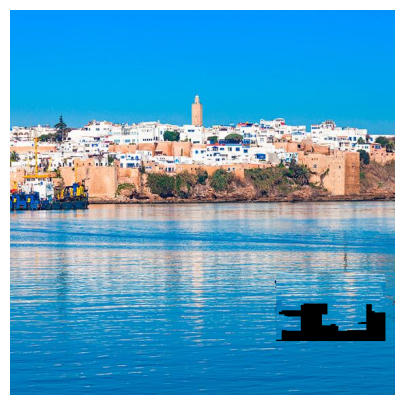

Iteration 420 completed


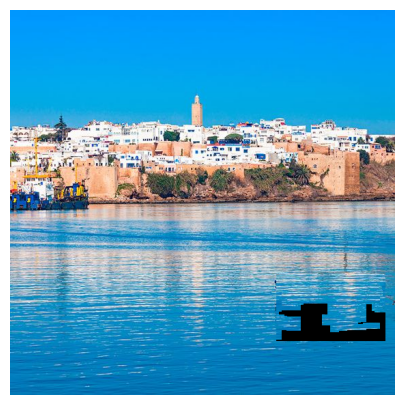

Iteration 430 completed


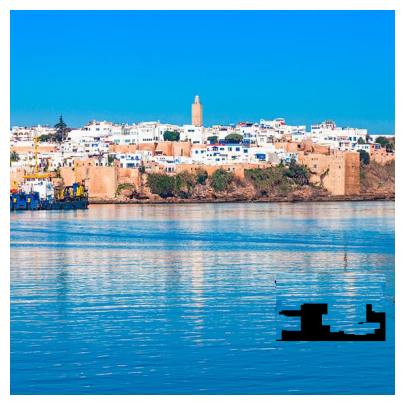

Iteration 440 completed


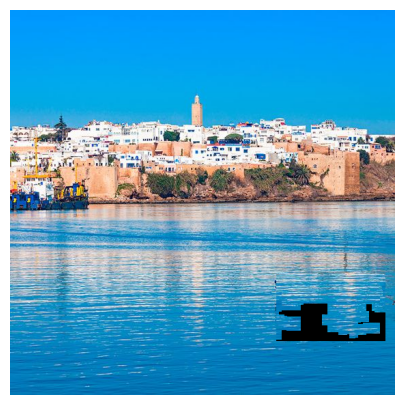

Iteration 450 completed


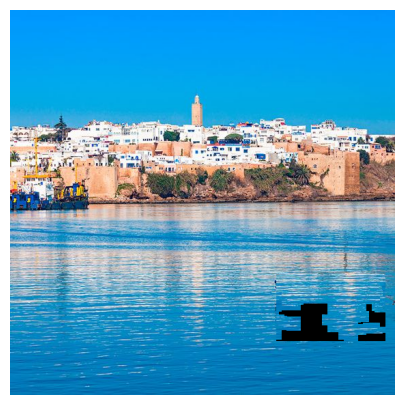

Iteration 460 completed


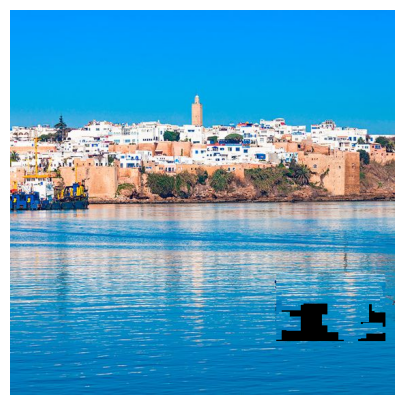

Iteration 470 completed


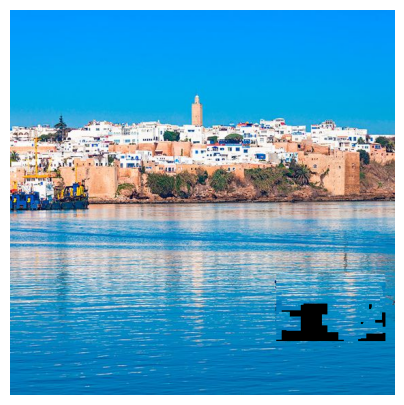

Iteration 480 completed


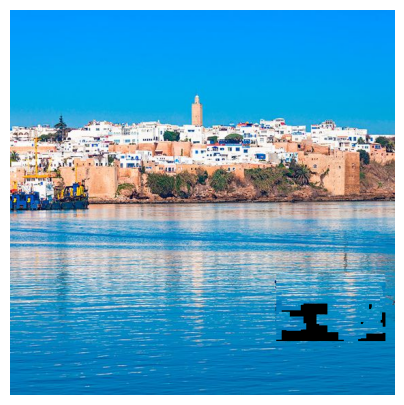

Iteration 490 completed


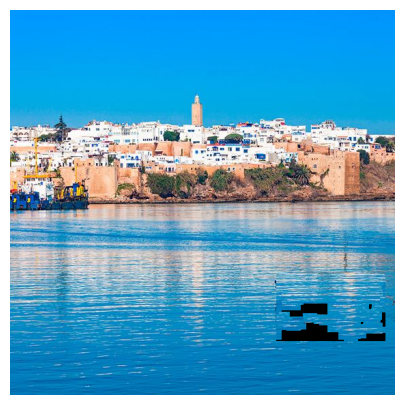

Iteration 500 completed


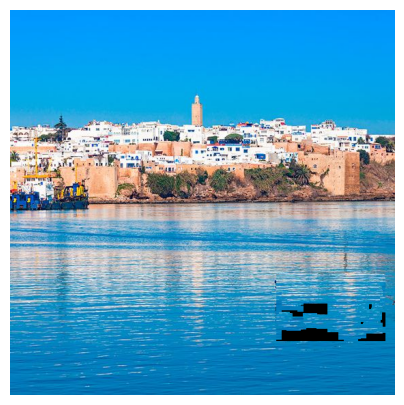

Iteration 510 completed


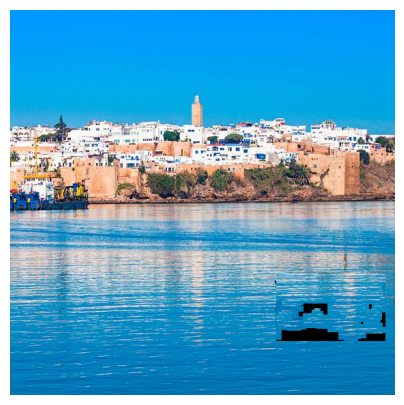

Iteration 520 completed


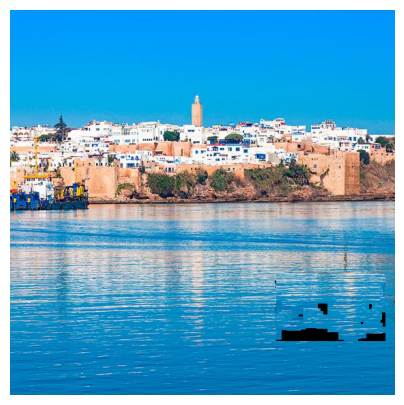

Iteration 530 completed


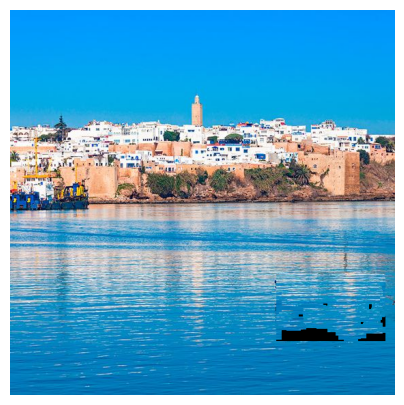

Iteration 540 completed


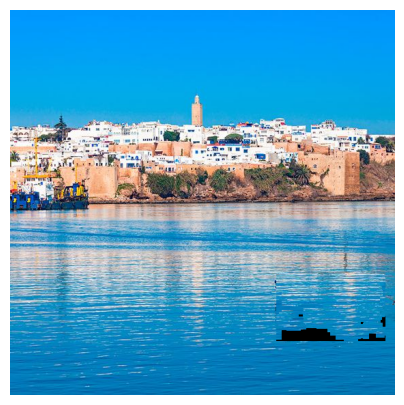

Iteration 550 completed


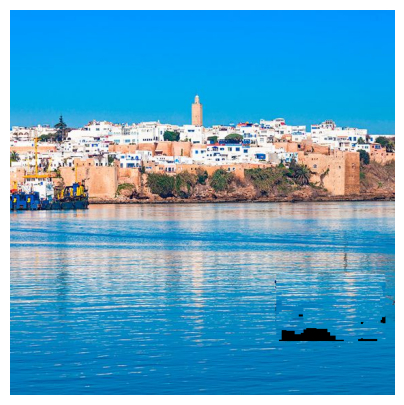

Iteration 560 completed


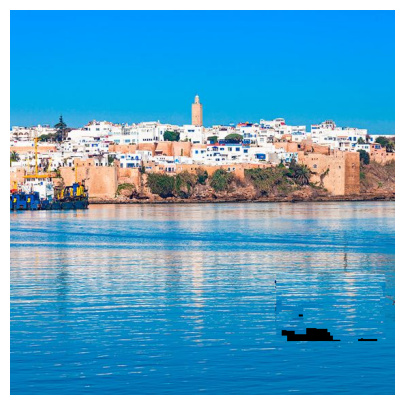

Iteration 570 completed


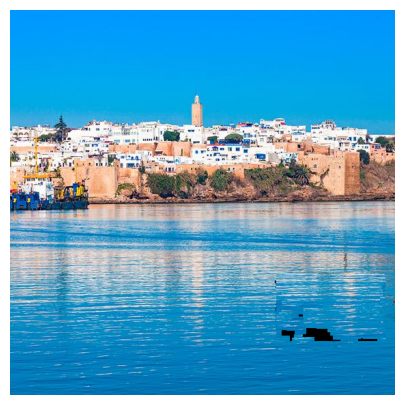

Iteration 580 completed


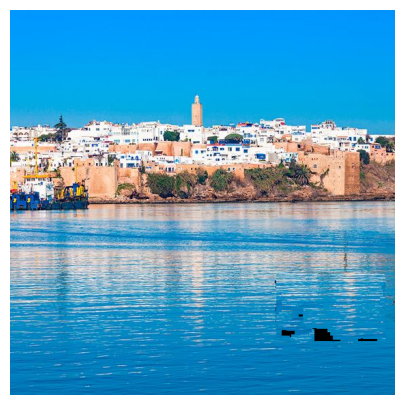

Iteration 590 completed


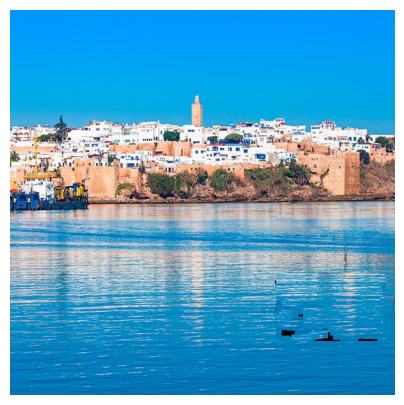

Iteration 600 completed


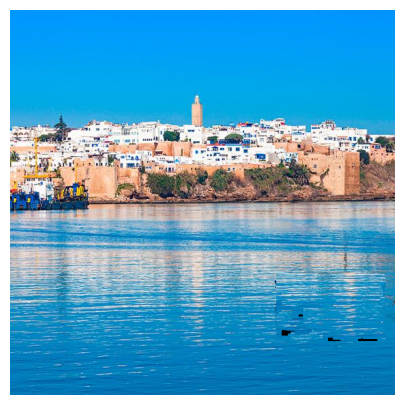

Iteration 610 completed


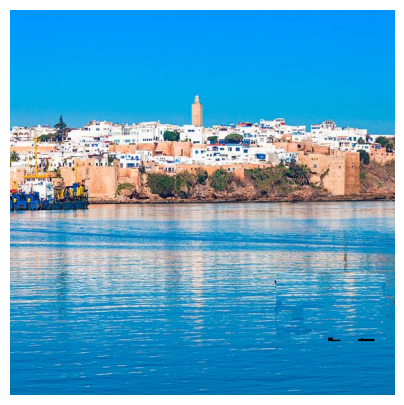

Iteration 620 completed


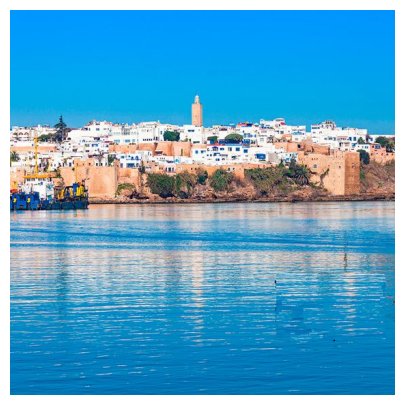

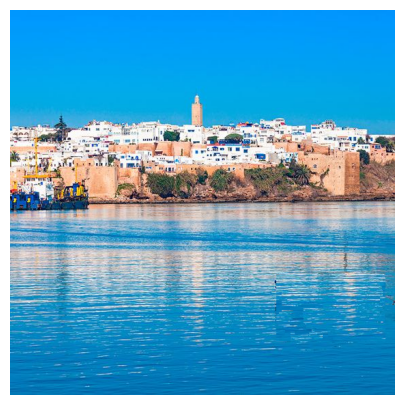

In [103]:
inpainted_image = iterate(image_brg, mask_brg, patch_size=9)

## Post-processing Attempt

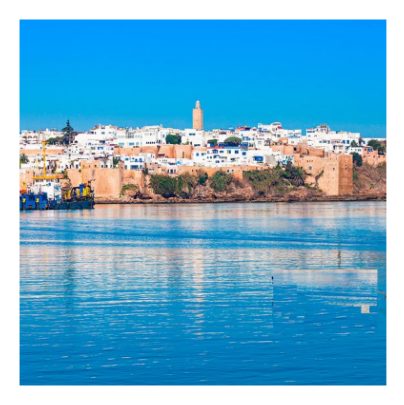

In [96]:
inpainted_image = cv2.imread('brg_inpainted.png', 1)
inpainted_image = cv2.cvtColor(inpainted_image, cv2.COLOR_BGR2RGB)
view_data(inpainted_image)

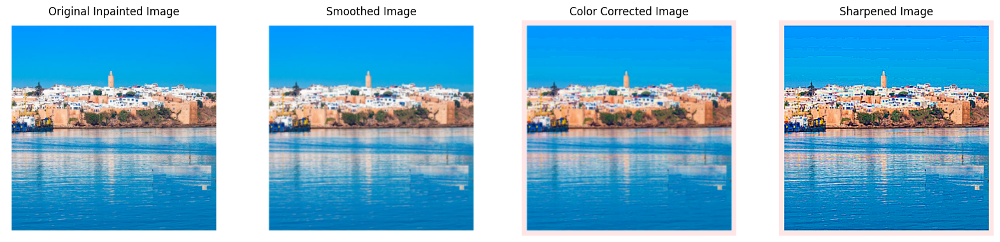

In [97]:
import cv2
import numpy as np
import matplotlib.pyplot as plt



# Apply Gaussian Blur to smooth the image
smoothed_image = cv2.GaussianBlur(inpainted_image, (3,3), 0)

# Color Correction - Convert to HSV, adjust, and convert back (example: increase saturation)
hsv_image = cv2.cvtColor(smoothed_image, cv2.COLOR_RGB2HSV)
h, s, v = cv2.split(hsv_image)
s = cv2.add(s, 25)  
hsv_image = cv2.merge([h, s, v])
color_corrected_image = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2RGB)

# Sharpening the image using a kernel

sharpen_kernel = np.array([[-0.5, -0.5, -0.5],
                           [-0.5, 5, -0.5],
                           [-0.5, -0.5, -0.5]])

sharpened_image = cv2.filter2D(color_corrected_image, -1, sharpen_kernel)

# Plotting the images
fig, axes = plt.subplots(1, 4, figsize=(20, 5))
ax = axes.ravel()

ax[0].imshow(inpainted_image)
ax[0].set_title('Original Inpainted Image')
ax[0].axis('off')

ax[1].imshow(smoothed_image)
ax[1].set_title('Smoothed Image')
ax[1].axis('off')

ax[2].imshow(color_corrected_image)
ax[2].set_title('Color Corrected Image')
ax[2].axis('off')

ax[3].imshow(sharpened_image)
ax[3].set_title('Sharpened Image')
ax[3].axis('off')

plt.show()
